**Mounting the drive and importing the libraries**

In [ ]:
!pip install tensorflow-addons

from google.colab import drive
drive.mount('/content/drive')

import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.layers import Dense, Reshape, Flatten, Conv2D, LeakyReLU, BatchNormalization, PReLU, Add, Input, UpSampling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import VGG19
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.optimizers.schedules import ExponentialDecay

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 18.1 MB/s eta 0:00:00
  Attempting uninstall: typeguard
    Found existing installation: typeguard 4.3.0
    Uninstalling typeguard-4.3.0:
      Successfully uninstalled typeguard-4.3.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
inflect 7.3.1 requires typeguard>=4.0.1, but you have typeguard 2.13.3 which is incompatible.
Mounted at /content/drive


**Pre-processing for SRGAN**

Loaded normal images shape: (913, 128, 128, 1)
Loaded pcos images shape: (675, 128, 128, 1)


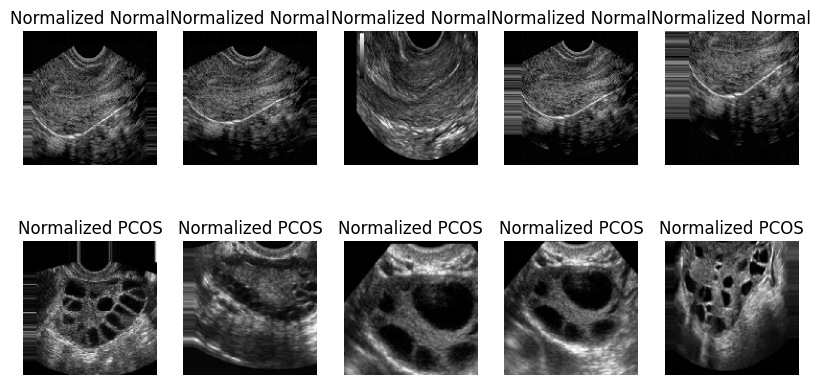

In [ ]:
#resizing to 128x128
img_height, img_width = 128, 128

#loading the images
def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img_path = os.path.join(folder, filename)
        if os.path.isfile(img_path):
            img = load_img(img_path, target_size=(img_height, img_width), color_mode='grayscale')
            img_array = img_to_array(img).astype(np.float32)
            images.append(img_array)
    return np.array(images)

normal_images = load_images_from_folder('/content/drive/MyDrive/Dataset/Train/NORMAL')
pcos_images = load_images_from_folder('/content/drive/MyDrive/Dataset/Train/PCOS')

#normalising
normal_images_norm = (normal_images / 127.5) - 1.0
pcos_images_norm = (pcos_images / 127.5) - 1.0

#denormalising for displaying images
def denormalize(images):
    return (images + 1.0) / 2.0

print("Loaded normal images shape:", normal_images.shape)
print("Loaded pcos images shape:", pcos_images.shape)

plt.figure(figsize=(10, 5))
for i in range(5):
    plt.subplot(2, 5, i+1)
    plt.imshow(normal_images_norm[i].squeeze(), cmap='gray')
    plt.axis('off')
    plt.title('Normalized Normal')
for i in range(5):
    plt.subplot(2, 5, i+6)
    plt.imshow(pcos_images_norm[i].squeeze(), cmap='gray')
    plt.axis('off')
    plt.title('Normalized PCOS')
plt.show()

**SRGAN-Variation 1**

In [ ]:
#generator
def build_generator_v1():
    input_layer = Input(shape=(img_height // 2, img_width // 2, 1))
    x = Conv2D(64, kernel_size=9, strides=1, padding='same')(input_layer)
    x = LeakyReLU(alpha=0.2)(x)

    x = UpSampling2D(size=2)(x)
    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = LeakyReLU(alpha=0.2)(x)

    output_layer = Conv2D(1, kernel_size=9, strides=1, padding='same', activation='tanh')(x)

    return Model(input_layer, output_layer)

#discriminator
def build_discriminator_v1():
    input_layer = Input(shape=(img_height, img_width, 1))

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(input_layer)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(64, kernel_size=3, strides=2, padding='same')(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(128, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(128, kernel_size=3, strides=2, padding='same')(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Flatten()(x)
    x = Dense(1024)(x)
    x = LeakyReLU(alpha=0.2)(x)
    output_layer = Dense(1, activation='sigmoid')(x)

    return Model(input_layer, output_layer)

optimizer_gen_v1 = Adam(learning_rate=0.0001, beta_1=0.5)
optimizer_disc_v1 = Adam(learning_rate=0.0001, beta_1=0.5)

discriminator_v1 = build_discriminator_v1()
discriminator_v1.compile(loss='binary_crossentropy', optimizer=optimizer_disc_v1, metrics=['accuracy'])

generator_v1 = build_generator_v1()

discriminator_v1.trainable = False
gan_input_v1 = Input(shape=(img_height // 2, img_width // 2, 1))
generated_image_v1 = generator_v1(gan_input_v1)
gan_output_v1 = discriminator_v1(generated_image_v1)
gan_v1 = Model(gan_input_v1, gan_output_v1)
gan_v1.compile(loss='binary_crossentropy', optimizer=optimizer_gen_v1)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [ ]:
epochs_v1 = 100
batch_size_v1 = 32
save_interval_v1 = 10

#creating directories to save images
generated_images_path_normal_v1 = '/content/drive/MyDrive/variation1images/Normal'
generated_images_path_pcos_v1 = '/content/drive/MyDrive/variation1images/PCOS'
generated_grid_path_normal_v1 = '/content/drive/MyDrive/variation1images/Grid_Normal'
generated_grid_path_pcos_v1 = '/content/drive/MyDrive/variation1images/Grid_PCOS'
os.makedirs(generated_images_path_normal_v1, exist_ok=True)
os.makedirs(generated_images_path_pcos_v1, exist_ok=True)
os.makedirs(generated_grid_path_normal_v1, exist_ok=True)
os.makedirs(generated_grid_path_pcos_v1, exist_ok=True)

def save_imgs_v1(epoch, generator, examples=10, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images_norm
        save_path = generated_images_path_normal_v1
    else:
        data = pcos_images_norm
        save_path = generated_images_path_pcos_v1

    idx = np.random.randint(0, data.shape[0], examples)
    low_res_imgs = data[idx]
    low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
    gen_imgs = generator.predict(low_res_imgs)
    gen_imgs = denormalize(gen_imgs)
    low_res_imgs = denormalize(low_res_imgs)

    for i in range(examples):
        fig, axs = plt.subplots(1, 2, figsize=(10, 4))
        axs[0].imshow(low_res_imgs[i, :, :, 0], cmap='gray')
        axs[0].axis('off')
        axs[1].imshow(gen_imgs[i, :, :, 0], cmap='gray')
        axs[1].axis('off')
        plt.savefig(os.path.join(save_path, f"{class_label}_epoch_{epoch}_{i}.png"))
        plt.close()

#saving images in a grid of 5x5
def save_grid_images_v1(epoch, generator, examples=25, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images_norm
        save_path = generated_grid_path_normal_v1
    else:
        data = pcos_images_norm
        save_path = generated_grid_path_pcos_v1

    idx = np.random.randint(0, data.shape[0], examples)
    low_res_imgs = data[idx]
    low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
    gen_imgs = generator.predict(low_res_imgs)
    gen_imgs = denormalize(gen_imgs)

    plt.figure(figsize=(10, 10))
    for i in range(examples):
        plt.subplot(5, 5, i+1)
        plt.imshow(gen_imgs[i, :, :, 0], cmap='gray')
        plt.axis('off')
    plt.savefig(os.path.join(save_path, f"{class_label}_grid_epoch_{epoch}.png"))
    plt.close()

**Training loop for variation 1**

In [ ]:
import pandas as pd

#initialising lists to store losses
d_losses = []
g_losses = []

#training loop
for epoch in range(epochs_v1):
    #training on NORMAL images
    idx = np.random.randint(0, normal_images_norm.shape[0], batch_size_v1)
    high_res_imgs = tf.convert_to_tensor(normal_images_norm[idx])
    low_res_imgs = tf.image.resize(high_res_imgs, [img_height // 2, img_width // 2])
    fake_high_res_imgs = generator_v1.predict(low_res_imgs)

    d_loss_real = discriminator_v1.train_on_batch(high_res_imgs, np.ones((batch_size_v1, 1)))
    d_loss_fake = discriminator_v1.train_on_batch(fake_high_res_imgs, np.zeros((batch_size_v1, 1)))
    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

    valid_y = np.ones((batch_size_v1, 1))
    g_loss = gan_v1.train_on_batch(low_res_imgs, valid_y)

    d_losses.append(d_loss[0])
    g_losses.append(g_loss)

    print(f"{epoch} [D loss: {d_loss[0]} | D accuracy: {100 * d_loss[1]}%] [G loss: {g_loss}]")

    if epoch % save_interval_v1 == 0:
        save_imgs_v1(epoch, generator_v1, class_label='NORMAL')
        save_grid_images_v1(epoch, generator_v1, class_label='NORMAL')

    #training on PCOS images
    idx = np.random.randint(0, pcos_images_norm.shape[0], batch_size_v1)
    high_res_imgs = tf.convert_to_tensor(pcos_images_norm[idx])
    low_res_imgs = tf.image.resize(high_res_imgs, [img_height // 2, img_width // 2])
    fake_high_res_imgs = generator_v1.predict(low_res_imgs)

    d_loss_real = discriminator_v1.train_on_batch(high_res_imgs, np.ones((batch_size_v1, 1)))
    d_loss_fake = discriminator_v1.train_on_batch(fake_high_res_imgs, np.zeros((batch_size_v1, 1)))
    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

    valid_y = np.ones((batch_size_v1, 1))
    g_loss = gan_v1.train_on_batch(low_res_imgs, valid_y)

    d_losses.append(d_loss[0])
    g_losses.append(g_loss)

    print(f"{epoch} [D loss: {d_loss[0]} | D accuracy: {100 * d_loss[1]}%] [G loss: {g_loss}]")

    if epoch % save_interval_v1 == 0:
        save_imgs_v1(epoch, generator_v1, class_label='PCOS')
        save_grid_images_v1(epoch, generator_v1, class_label='PCOS')




1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


/usr/local/lib/python3.10/dist-packages/keras/src/backend/tensorflow/trainer.py:75: UserWarning: The model does not have any trainable weights.
  warnings.warn("The model does not have any trainable weights.")


0 [D loss: 0.7010604739189148 | D accuracy: 23.4375%] [G loss: [array(0.6983993, dtype=float32), array(0.6983993, dtype=float32), array(0.3125, dtype=float32)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 892ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


0 [D loss: 0.6975681781768799 | D accuracy: 33.33333134651184%] [G loss: [array(0.69697356, dtype=float32), array(0.69697356, dtype=float32), array(0.34375, dtype=float32)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1 [D loss: 0.6979721188545227 | D accuracy: 29.16666865348816%] [G loss: [array(0.69755554, dtype=float32), array(0.69755554, dtype=float32), array(0.30208334, dtype=float32)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1 [D loss: 0.6977304816246033 | D accuracy: 28.59933078289032%] [G loss: [array(0.69747925, dtype=float32), array(0.69747925, dtype=float32), array(0.27734375, dtype=float32)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
2 [D loss: 0.6978694200515747 | D accuracy: 25.815972685813904%] [G loss: [array(0.6976923, dtype=float32), array(0.6976923, dtype=float32), array(0.259375, dtype=float32)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
2 [D loss: 0.6975384950637817 | D accuracy: 25.710225105285645%] [G loss: [arra

**Displaying images for last epoch**

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step


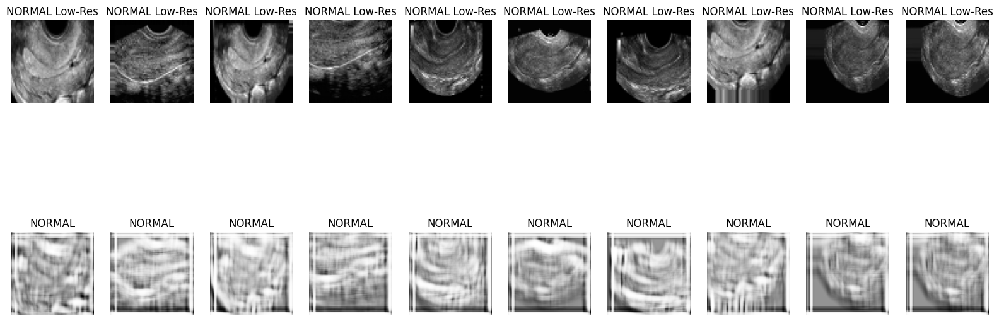

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


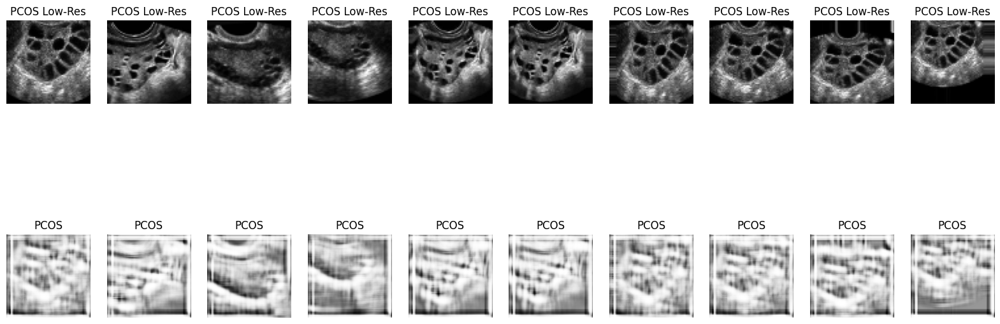

In [ ]:
def display_last_epoch_images_v1(generator, examples=10):
    def display_images(class_label):
        if class_label == 'NORMAL':
            data = normal_images_norm
        else:
            data = pcos_images_norm

        idx = np.random.randint(0, data.shape[0], examples)
        low_res_imgs = data[idx]
        low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
        gen_imgs = generator.predict(low_res_imgs)
        gen_imgs = denormalize(gen_imgs)
        low_res_imgs = denormalize(low_res_imgs)

        plt.figure(figsize=(20, 8))
        for i in range(examples):
            plt.subplot(2, examples, i+1)
            plt.imshow(low_res_imgs[i, :, :, 0], cmap='gray')
            plt.axis('off')
            plt.title(f'{class_label} Low-Res')

            plt.subplot(2, examples, i+1+examples)
            plt.imshow(gen_imgs[i, :, :, 0], cmap='gray')
            plt.axis('off')
            plt.title(f'{class_label}')

        plt.show()


    display_images('NORMAL')
    display_images('PCOS')

display_last_epoch_images_v1(generator_v1)

**Variation 2 (addition of residual blocks)**

In [ ]:
#residual blocks
def residual_block_v2(input_layer, filters):
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same')(input_layer)
    x = BatchNormalization(momentum=0.8)(x)
    x = PReLU(shared_axes=[1, 2])(x)
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization(momentum=0.8)(x)
    return Add()([input_layer, x])

#generator
def build_generator_v2():
    input_layer = Input(shape=(img_height // 2, img_width // 2, 1))
    x = Conv2D(64, kernel_size=9, strides=1, padding='same')(input_layer)
    x = PReLU(shared_axes=[1, 2])(x)

    r = residual_block_v2(x, 64)
    for _ in range(5):  #initialising for 5 residual blocks
        r = residual_block_v2(r, 64)

    r = Conv2D(64, kernel_size=3, strides=1, padding='same')(r)
    r = BatchNormalization(momentum=0.8)(r)
    x = Add()([x, r])

    x = UpSampling2D(size=2)(x)
    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = PReLU(shared_axes=[1, 2])(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = PReLU(shared_axes=[1, 2])(x)

    output_layer = Conv2D(1, kernel_size=9, strides=1, padding='same', activation='tanh')(x)

    return Model(input_layer, output_layer)

#discriminator with spectral normalisation
def build_discriminator_v2():
    input_layer = Input(shape=(img_height, img_width, 1))

    x = SpectralNormalization(Conv2D(64, kernel_size=3, strides=1, padding='same'))(input_layer)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(64, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(128, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(128, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(256, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(256, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(512, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(512, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Flatten()(x)
    x = Dense(1024)(x)
    x = LeakyReLU(alpha=0.2)(x)
    output_layer = Dense(1, activation='sigmoid')(x)

    return Model(input_layer, output_layer)

optimizer_gen_v2 = Adam(learning_rate=0.0002, beta_1=0.5)
optimizer_disc_v2 = Adam(learning_rate=0.0002, beta_1=0.5)

discriminator_v2 = build_discriminator_v2()
discriminator_v2.compile(loss='binary_crossentropy', optimizer=optimizer_disc_v2, metrics=['accuracy'])

generator_v2 = build_generator_v2()

discriminator_v2.trainable = False
gan_input_v2 = Input(shape=(img_height // 2, img_width // 2, 1))
generated_image_v2 = generator_v2(gan_input_v2)
gan_output_v2 = discriminator_v2(generated_image_v2)
gan_v2 = Model(gan_input_v2, gan_output_v2)
gan_v2.compile(loss='binary_crossentropy', optimizer=optimizer_gen_v2)

In [ ]:
epochs_v2 = 100
batch_size_v2 = 32
save_interval_v2 = 10

generated_images_path_normal_v2 = '/content/drive/MyDrive/variation2images/Normal'
generated_images_path_pcos_v2 = '/content/drive/MyDrive/variation2images/PCOS'
generated_grid_path_normal_v2 = '/content/drive/MyDrive/variation2images/Grid_Normal'
generated_grid_path_pcos_v2 = '/content/drive/MyDrive/variation2images/Grid_PCOS'
os.makedirs(generated_images_path_normal_v2, exist_ok=True)
os.makedirs(generated_images_path_pcos_v2, exist_ok=True)
os.makedirs(generated_grid_path_normal_v2, exist_ok=True)
os.makedirs(generated_grid_path_pcos_v2, exist_ok=True)

def save_imgs_v2(epoch, generator, examples=10, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images_norm
        save_path = generated_images_path_normal_v2
    else:
        data = pcos_images_norm
        save_path = generated_images_path_pcos_v2

    idx = np.random.randint(0, data.shape[0], examples)
    low_res_imgs = data[idx]
    low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
    gen_imgs = generator_v2.predict(low_res_imgs)
    gen_imgs = denormalize(gen_imgs)
    low_res_imgs = denormalize(low_res_imgs)

    for i in range(examples):
        fig, axs = plt.subplots(1, 2, figsize=(10, 4))
        axs[0].imshow(low_res_imgs[i, :, :, 0], cmap='gray')
        axs[0].axis('off')
        axs[1].imshow(gen_imgs[i, :, :, 0], cmap='gray')
        axs[1].axis('off')
        plt.savefig(os.path.join(save_path, f"{class_label}_epoch_{epoch}_{i}.png"))
        plt.close()

def save_grid_images_v2(epoch, generator, examples=25, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images_norm
        save_path = generated_grid_path_normal_v2
    else:
        data = pcos_images_norm
        save_path = generated_grid_path_pcos_v2

    idx = np.random.randint(0, data.shape[0], examples)
    low_res_imgs = data[idx]
    low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
    gen_imgs = generator_v2.predict(low_res_imgs)
    gen_imgs = denormalize(gen_imgs)

    plt.figure(figsize=(10, 10))
    for i in range(examples):
        plt.subplot(5, 5, i+1)
        plt.imshow(gen_imgs[i, :, :, 0], cmap='gray')
        plt.axis('off')
    plt.savefig(os.path.join(save_path, f"{class_label}_grid_epoch_{epoch}.png"))
    plt.close()

**Training Loop for Variation 2**

In [ ]:
d_losses_epoch = []
g_losses_epoch = []

#training loop
for epoch in range(epochs_v2):

    d_loss_acc = []
    g_loss_acc = []

    idx = np.random.randint(0, normal_images_norm.shape[0], batch_size_v2)
    high_res_imgs = tf.convert_to_tensor(normal_images_norm[idx])
    low_res_imgs = tf.image.resize(high_res_imgs, [img_height // 2, img_width // 2])
    fake_high_res_imgs = generator_v2.predict(low_res_imgs)

    d_loss_real = discriminator_v2.train_on_batch(high_res_imgs, np.ones((batch_size_v2, 1)))
    d_loss_fake = discriminator_v2.train_on_batch(fake_high_res_imgs, np.zeros((batch_size_v2, 1)))
    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
    d_loss_acc.append(d_loss[0])

    valid_y = np.ones((batch_size_v2, 1))
    g_loss = gan_v2.train_on_batch(low_res_imgs, valid_y)
    g_loss_acc.append(g_loss)

    print(f"Normal {epoch} [D loss: {d_loss[0]} | D accuracy: {100 * d_loss[1]}%] [G loss: {g_loss}]")

    if epoch % save_interval_v2 == 0:
        save_imgs_v2(epoch, generator_v2, class_label='NORMAL')
        save_grid_images_v2(epoch, generator_v2, class_label='NORMAL')

    idx = np.random.randint(0, pcos_images_norm.shape[0], batch_size_v2)
    high_res_imgs = tf.convert_to_tensor(pcos_images_norm[idx])
    low_res_imgs = tf.image.resize(high_res_imgs, [img_height // 2, img_width // 2])
    fake_high_res_imgs = generator_v2.predict(low_res_imgs)

    d_loss_real = discriminator_v2.train_on_batch(high_res_imgs, np.ones((batch_size_v2, 1)))
    d_loss_fake = discriminator_v2.train_on_batch(fake_high_res_imgs, np.zeros((batch_size_v2, 1)))
    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
    d_loss_acc.append(d_loss[0])

    valid_y = np.ones((batch_size_v2, 1))
    g_loss = gan_v2.train_on_batch(low_res_imgs, valid_y)
    g_loss_acc.append(g_loss)

    print(f"PCOS {epoch} [D loss: {d_loss[0]} | D accuracy: {100 * d_loss[1]}%] [G loss: {g_loss}]")

    if epoch % save_interval_v2 == 0:
        save_imgs_v2(epoch, generator_v2, class_label='PCOS')
        save_grid_images_v2(epoch, generator_v2, class_label='PCOS')

    d_losses_epoch.append(np.mean(d_loss_acc))
    g_losses_epoch.append(np.mean(g_loss_acc))

1/1 [==============================] - 9s 9s/step
Normal 0 [D loss: 22.702696591615677 | D accuracy: 32.8125%] [G loss: 0.09520024061203003]
1/1 [==============================] - 7s 7s/step
PCOS 0 [D loss: 7.18579149248725 | D accuracy: 50.0%] [G loss: 1.7044274806976318]
1/1 [==============================] - 6s 6s/step
Normal 1 [D loss: 2.7195394207374193 | D accuracy: 51.5625%] [G loss: 0.5058450698852539]
1/1 [==============================] - 8s 8s/step
PCOS 1 [D loss: 0.3625793009996414 | D accuracy: 81.25%] [G loss: 0.41955697536468506]
1/1 [==============================] - 8s 8s/step
Normal 2 [D loss: 0.0002796045027935179 | D accuracy: 100.0%] [G loss: 0.22381213307380676]
1/1 [==============================] - 8s 8s/step
PCOS 2 [D loss: 0.05215848378429655 | D accuracy: 96.875%] [G loss: 0.14486682415008545]
1/1 [==============================] - 9s 9s/step
Normal 3 [D loss: 0.0002933246905740816 | D accuracy: 100.0%] [G loss: 0.00821426510810852]
1/1 [=====================

**displaying images for last epoch**

1/1 [==============================] - 2s 2s/step


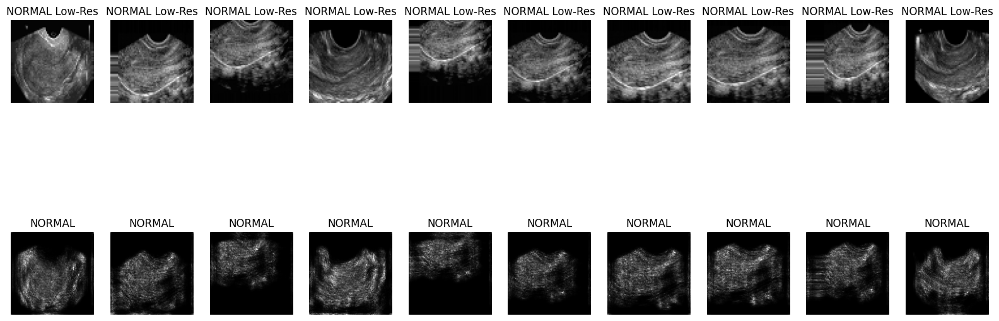

1/1 [==============================] - 2s 2s/step


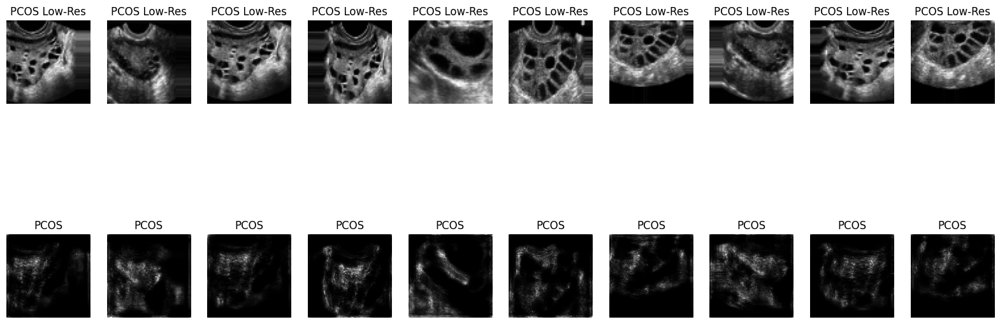

In [ ]:
def display_last_epoch_images_v2(generator, examples=10):
    def display_images(class_label):
        if class_label == 'NORMAL':
            data = normal_images_norm
        else:
            data = pcos_images_norm

        idx = np.random.randint(0, data.shape[0], examples)
        low_res_imgs = data[idx]
        low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
        gen_imgs = generator_v2.predict(low_res_imgs)
        gen_imgs = denormalize(gen_imgs)
        low_res_imgs = denormalize(low_res_imgs)

        plt.figure(figsize=(20, 8))
        for i in range(examples):
            plt.subplot(2, examples, i+1)
            plt.imshow(low_res_imgs[i, :, :, 0], cmap='gray')
            plt.axis('off')
            plt.title(f'{class_label} Low-Res')

            plt.subplot(2, examples, i+1+examples)
            plt.imshow(gen_imgs[i, :, :, 0], cmap='gray')
            plt.axis('off')
            plt.title(f'{class_label}')

        plt.show()

    display_images('NORMAL')
    display_images('PCOS')

display_last_epoch_images_v2(generator_v2)

**Variation 3**

In [ ]:
#defining VGG19 model for perpetual loss
vgg_v3 = VGG19(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
vgg_v3.trainable = False
vgg_model_v3 = Model(inputs=vgg_v3.input, outputs=vgg_v3.get_layer('block5_conv4').output)
mse_loss_v3 = MeanSquaredError()

def perceptual_loss_v3(y_true, y_pred):
    y_true_rgb = tf.image.grayscale_to_rgb(y_true)
    y_pred_rgb = tf.image.grayscale_to_rgb(y_pred)
    y_true_vgg = vgg_model_v3(y_true_rgb)
    y_pred_vgg = vgg_model_v3(y_pred_rgb)
    return mse_loss_v3(y_true_vgg, y_pred_vgg)

#residual block
def residual_block_v3(input_layer, filters):
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same')(input_layer)
    x = BatchNormalization(momentum=0.8)(x)
    x = PReLU(shared_axes=[1, 2])(x)
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization(momentum=0.8)(x)
    return Add()([input_layer, x])

#generator
def build_generator_v3():
    input_layer = Input(shape=(img_height // 2, img_width // 2, 1))
    x = Conv2D(64, kernel_size=9, strides=1, padding='same')(input_layer)
    x = PReLU(shared_axes=[1, 2])(x)

    r = residual_block_v3(x, 64)
    for _ in range(15):  #increasing to 15 residual blocks as compared to variation 2
        r = residual_block_v3(r, 64)

    r = Conv2D(64, kernel_size=3, strides=1, padding='same')(r)
    r = BatchNormalization(momentum=0.8)(r)
    x = Add()([x, r])

    x = UpSampling2D(size=2)(x)
    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = PReLU(shared_axes=[1, 2])(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = PReLU(shared_axes=[1, 2])(x)

    output_layer = Conv2D(1, kernel_size=9, strides=1, padding='same', activation='tanh')(x)

    return Model(input_layer, output_layer)

#discriminator with spectral normalisation
def build_discriminator_v3():
    input_layer = Input(shape=(img_height, img_width, 1))

    x = SpectralNormalization(Conv2D(64, kernel_size=3, strides=1, padding='same'))(input_layer)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(64, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(128, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(128, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(256, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(256, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(512, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(512, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Flatten()(x)
    x = Dense(1024)(x)
    x = LeakyReLU(alpha=0.2)(x)
    output_layer = Dense(1, activation='sigmoid')(x)

    return Model(input_layer, output_layer)

optimizer_gen_v3 = Adam(learning_rate=0.0002, beta_1=0.5)
optimizer_disc_v3 = Adam(learning_rate=0.0002, beta_1=0.5)

discriminator_v3 = build_discriminator_v3()
discriminator_v3.compile(loss='binary_crossentropy', optimizer=optimizer_disc_v3, metrics=['accuracy'])

generator_v3 = build_generator_v3()

discriminator_v3.trainable = False
gan_input_v3 = Input(shape=(img_height // 2, img_width // 2, 1))
generated_image_v3 = generator_v3(gan_input_v3)
gan_output_v3 = discriminator_v3(generated_image_v3)
gan_v3 = Model(gan_input_v3, gan_output_v3)
gan_v3.compile(loss='binary_crossentropy', optimizer=optimizer_gen_v3)

80134624/80134624 [==============================] - 1s 0us/step


In [ ]:
epochs_v3 = 100
batch_size_v3 = 32
save_interval_v3 = 10

generated_images_path_normal_v3 = '/content/drive/MyDrive/variation3images/Normal'
generated_images_path_pcos_v3 = '/content/drive/MyDrive/variation3images/PCOS'
generated_grid_path_normal_v3 = '/content/drive/MyDrive/variation3images/Grid_Normal'
generated_grid_path_pcos_v3 = '/content/drive/MyDrive/variation3images/Grid_PCOS'
os.makedirs(generated_images_path_normal_v3, exist_ok=True)
os.makedirs(generated_images_path_pcos_v3, exist_ok=True)
os.makedirs(generated_grid_path_normal_v3, exist_ok=True)
os.makedirs(generated_grid_path_pcos_v3, exist_ok=True)

def save_imgs_v3(epoch, generator, examples=10, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images_norm
        save_path = generated_images_path_normal_v3
    else:
        data = pcos_images_norm
        save_path = generated_images_path_pcos_v3

    idx = np.random.randint(0, data.shape[0], examples)
    low_res_imgs = data[idx]
    low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
    gen_imgs = generator_v3.predict(low_res_imgs)
    gen_imgs = denormalize(gen_imgs)
    low_res_imgs = denormalize(low_res_imgs)

    for i in range(examples):
        fig, axs = plt.subplots(1, 2, figsize=(10, 4))
        axs[0].imshow(low_res_imgs[i, :, :, 0], cmap='gray')
        axs[0].axis('off')
        axs[1].imshow(gen_imgs[i, :, :, 0], cmap='gray')
        axs[1].axis('off')
        plt.savefig(os.path.join(save_path, f"{class_label}_epoch_{epoch}_{i}.png"))
        plt.close()

def save_grid_images_v3(epoch, generator, examples=25, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images_norm
        save_path = generated_grid_path_normal_v3
    else:
        data = pcos_images_norm
        save_path = generated_grid_path_pcos_v3

    idx = np.random.randint(0, data.shape[0], examples)
    low_res_imgs = data[idx]
    low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
    gen_imgs = generator_v3.predict(low_res_imgs)
    gen_imgs = denormalize(gen_imgs)

    plt.figure(figsize=(10, 10))
    for i in range(examples):
        plt.subplot(5, 5, i+1)
        plt.imshow(gen_imgs[i, :, :, 0], cmap='gray')
        plt.axis('off')
    plt.savefig(os.path.join(save_path, f"{class_label}_grid_epoch_{epoch}.png"))
    plt.close()

In [ ]:
d_losses_epoch = []
g_losses_epoch = []
perceptual_losses_epoch = []

for epoch in range(epochs_v3):

    d_loss_acc = []
    g_loss_acc = []
    perceptual_loss_acc = []

    idx = np.random.randint(0, normal_images_norm.shape[0], batch_size_v3)
    high_res_imgs = tf.convert_to_tensor(normal_images_norm[idx])
    low_res_imgs = tf.image.resize(high_res_imgs, [img_height // 2, img_width // 2])
    fake_high_res_imgs = generator_v3.predict(low_res_imgs)
    fake_high_res_imgs = tf.convert_to_tensor(fake_high_res_imgs)

    d_loss_real = discriminator_v3.train_on_batch(high_res_imgs, np.ones((batch_size_v3, 1)))
    d_loss_fake = discriminator_v3.train_on_batch(fake_high_res_imgs, np.zeros((batch_size_v3, 1)))
    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
    d_loss_acc.append(d_loss[0])

    valid_y = np.ones((batch_size_v3, 1))
    g_loss = gan_v3.train_on_batch(low_res_imgs, valid_y)
    perceptual_loss_value = perceptual_loss_v3(high_res_imgs, fake_high_res_imgs)
    g_loss_total = g_loss + perceptual_loss_value

    g_loss_acc.append(g_loss)
    perceptual_loss_acc.append(perceptual_loss_value.numpy())

    print(f"{epoch} [D loss: {d_loss[0]} | D accuracy: {100 * d_loss[1]}%] [G loss: {g_loss_total}]")

    if epoch % save_interval_v3 == 0:
        save_imgs_v3(epoch, generator_v3, class_label='NORMAL')
        save_grid_images_v3(epoch, generator_v3, class_label='NORMAL')

    idx = np.random.randint(0, pcos_images_norm.shape[0], batch_size_v3)
    high_res_imgs = tf.convert_to_tensor(pcos_images_norm[idx])
    low_res_imgs = tf.image.resize(high_res_imgs, [img_height // 2, img_width // 2])
    fake_high_res_imgs = generator_v3.predict(low_res_imgs)
    fake_high_res_imgs = tf.convert_to_tensor(fake_high_res_imgs)

    d_loss_real = discriminator_v3.train_on_batch(high_res_imgs, np.ones((batch_size_v3, 1)))
    d_loss_fake = discriminator_v3.train_on_batch(fake_high_res_imgs, np.zeros((batch_size_v3, 1)))
    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
    d_loss_acc.append(d_loss[0])

    g_loss = gan_v3.train_on_batch(low_res_imgs, valid_y)
    perceptual_loss_value = perceptual_loss_v3(high_res_imgs, fake_high_res_imgs)
    g_loss_total = g_loss + perceptual_loss_value

    g_loss_acc.append(g_loss)
    perceptual_loss_acc.append(perceptual_loss_value.numpy())

    print(f"{epoch} [D loss: {d_loss[0]} | D accuracy: {100 * d_loss[1]}%] [G loss: {g_loss_total}]")

    if epoch % save_interval_v3 == 0:
        save_imgs_v3(epoch, generator_v3, class_label='PCOS')
        save_grid_images_v3(epoch, generator_v3, class_label='PCOS')

    d_losses_epoch.append(np.mean(d_loss_acc))
    g_losses_epoch.append(np.mean(g_loss_acc))
    perceptual_losses_epoch.append(np.mean(perceptual_loss_acc))


1/1 [==============================] - 15s 15s/step
0 [D loss: 22.853540748357773 | D accuracy: 14.0625%] [G loss: 0.15439671277999878]
1/1 [==============================] - 10s 10s/step
0 [D loss: 8.909475326593498 | D accuracy: 50.0%] [G loss: 1.4317163228988647]
1/1 [==============================] - 11s 11s/step
1 [D loss: 1.14876633672975 | D accuracy: 57.8125%] [G loss: 0.9537174105644226]
1/1 [==============================] - 12s 12s/step
1 [D loss: 2.5652947425842285 | D accuracy: 40.625%] [G loss: 1.084208369255066]
1/1 [==============================] - 10s 10s/step
2 [D loss: 0.0022711707279086113 | D accuracy: 100.0%] [G loss: 1.8512033224105835]
1/1 [==============================] - 12s 12s/step
2 [D loss: 0.2447868259769166 | D accuracy: 87.5%] [G loss: 0.3170987367630005]
1/1 [==============================] - 11s 11s/step
3 [D loss: 2.3589850605640095 | D accuracy: 50.0%] [G loss: 6.251188278198242]
1/1 [==============================] - 13s 13s/step
3 [D loss: 1.670

**Displaying images for last epoch**

1/1 [==============================] - 1s 1s/step


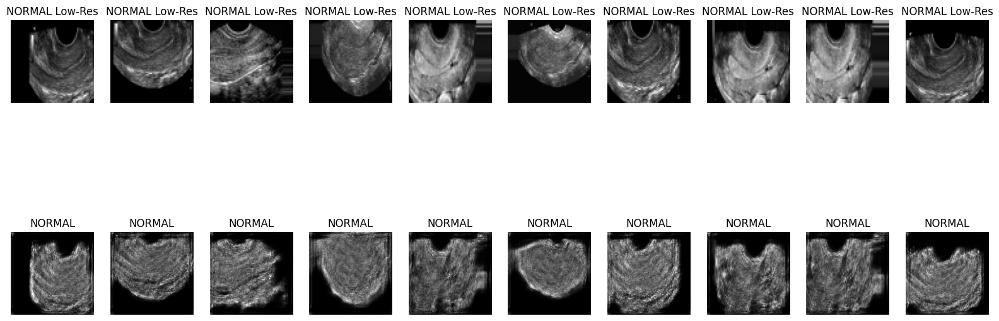

1/1 [==============================] - 2s 2s/step


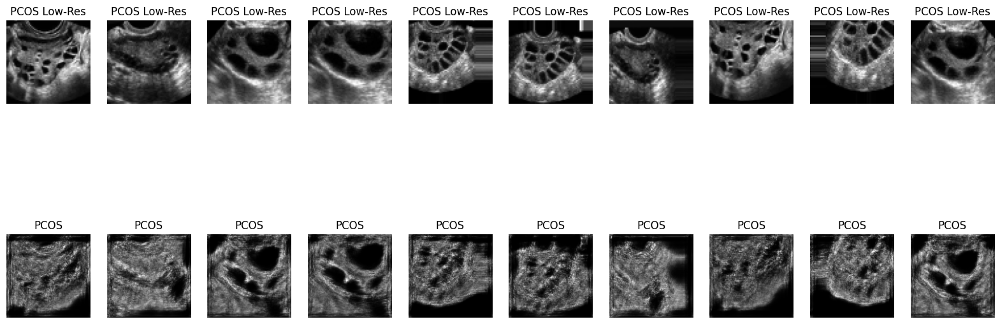

In [ ]:
def display_last_epoch_images_v2(generator, examples=10):
    def display_images(class_label):
        if class_label == 'NORMAL':
            data = normal_images_norm
        else:
            data = pcos_images_norm

        idx = np.random.randint(0, data.shape[0], examples)
        low_res_imgs = data[idx]
        low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
        gen_imgs = generator_v2.predict(low_res_imgs)
        gen_imgs = denormalize(gen_imgs)
        low_res_imgs = denormalize(low_res_imgs)

        plt.figure(figsize=(20, 8))
        for i in range(examples):
            plt.subplot(2, examples, i+1)
            plt.imshow(low_res_imgs[i, :, :, 0], cmap='gray')
            plt.axis('off')
            plt.title(f'{class_label} Low-Res')

            plt.subplot(2, examples, i+1+examples)
            plt.imshow(gen_imgs[i, :, :, 0], cmap='gray')
            plt.axis('off')
            plt.title(f'{class_label}')

        plt.show()

    display_images('NORMAL')
    display_images('PCOS')

display_last_epoch_images_v2(generator_v2)

**Variation 4**

In [ ]:
vgg_v5 = VGG19(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
vgg_v5.trainable = False
vgg_model_v5 = Model(inputs=vgg_v5.input, outputs=vgg_v5.get_layer('block5_conv4').output)
mse_loss_v5 = MeanSquaredError()

def perceptual_loss_v5(y_true, y_pred):
    y_true_rgb = tf.image.grayscale_to_rgb(y_true)
    y_pred_rgb = tf.image.grayscale_to_rgb(y_pred)
    y_true_vgg = vgg_model_v5(y_true_rgb)
    y_pred_vgg = vgg_model_v5(y_pred_rgb)
    return mse_loss_v5(y_true_vgg, y_pred_vgg)

#residual blocks
def residual_block_v5(input_layer, filters):
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same')(input_layer)
    x = BatchNormalization(momentum=0.8)(x)
    x = PReLU(shared_axes=[1, 2])(x)
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization(momentum=0.8)(x)
    return Add()([input_layer, x])

#generator
def build_generator_v5():
    input_layer = Input(shape=(img_height // 2, img_width // 2, 1))
    x = Conv2D(64, kernel_size=9, strides=1, padding='same')(input_layer)
    x = PReLU(shared_axes=[1, 2])(x)

    r = residual_block_v5(x, 64)
    for _ in range(16):  #increasing the residual blocks to 16 in this case
        r = residual_block_v5(r, 64)

    r = Conv2D(64, kernel_size=3, strides=1, padding='same')(r)
    r = BatchNormalization(momentum=0.8)(r)
    x = Add()([x, r])

    x = UpSampling2D(size=2)(x)
    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = PReLU(shared_axes=[1, 2])(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = PReLU(shared_axes=[1, 2])(x)

    output_layer = Conv2D(1, kernel_size=9, strides=1, padding='same', activation='tanh')(x)

    return Model(input_layer, output_layer)

#discriminator with spectral normalisation
def build_discriminator_v5():
    input_layer = Input(shape=(img_height, img_width, 1))

    x = SpectralNormalization(Conv2D(64, kernel_size=3, strides=1, padding='same'))(input_layer)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(64, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(128, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(128, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(256, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(256, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(512, kernel_size=3, strides=1, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = SpectralNormalization(Conv2D(512, kernel_size=3, strides=2, padding='same'))(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Flatten()(x)
    x = Dense(1024)(x)
    x = LeakyReLU(alpha=0.2)(x)
    output_layer = Dense(1, activation='sigmoid')(x)

    return Model(input_layer, output_layer)

#learning rate
learning_rate_gen_v5 = ExponentialDecay(0.0001, decay_steps=100000, decay_rate=0.96, staircase=True)
learning_rate_disc_v5 = ExponentialDecay(0.00005, decay_steps=100000, decay_rate=0.96, staircase=True)

#optimizers with learning rates and gradient clipping
optimizer_gen_v5 = Adam(learning_rate=learning_rate_gen_v5, beta_1=0.5, beta_2=0.999, clipvalue=1.0)
optimizer_disc_v5 = Adam(learning_rate=learning_rate_disc_v5, beta_1=0.5, beta_2=0.999, clipvalue=1.0)

discriminator_v5 = build_discriminator_v5()
discriminator_v5.compile(loss='binary_crossentropy', optimizer=optimizer_disc_v5, metrics=['accuracy'])

generator_v5 = build_generator_v5()

discriminator_v5.trainable = False
gan_input_v5 = Input(shape=(img_height // 2, img_width // 2, 1))
generated_image_v5 = generator_v5(gan_input_v5)
gan_output_v5 = discriminator_v5(generated_image_v5)
gan_v5 = Model(gan_input_v5, gan_output_v5)
gan_v5.compile(loss='binary_crossentropy', optimizer=optimizer_gen_v5)


def scheduler_v5(epoch, lr):
    if epoch < 20:
        return lr
    else:
        return lr * tf.math.exp(-0.1)


80134624/80134624 [==============================] - 0s 0us/step


In [ ]:
epochs_v5 = 100
batch_size_v5 = 32
save_interval_v5 = 1

generated_images_path_normal_v5 = '/content/drive/MyDrive/variation4images/allnormal'
generated_images_path_pcos_v5 = '/content/drive/MyDrive/variation4images/allpcos'
generated_grid_path_normal_v5 = '/content/drive/MyDrive/variation4images/gridallnormal'
generated_grid_path_pcos_v5 = '/content/drive/MyDrive/variation4images/gridallpcos'
os.makedirs(generated_images_path_normal_v5, exist_ok=True)
os.makedirs(generated_images_path_pcos_v5, exist_ok=True)
os.makedirs(generated_grid_path_normal_v5, exist_ok=True)
os.makedirs(generated_grid_path_pcos_v5, exist_ok=True)

def save_imgs_v5(epoch, generator, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images_norm
        save_path = generated_images_path_normal_v5
    else:
        data = pcos_images_norm
        save_path = generated_images_path_pcos_v5

    low_res_imgs = data
    low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
    gen_imgs = generator.predict(low_res_imgs)
    gen_imgs = denormalize(gen_imgs)
    low_res_imgs = denormalize(low_res_imgs)
    os.makedirs(os.path.join(save_path, f"epoch_{epoch}"), exist_ok=True)
    for i in range(data.shape[0]):
        plt.imsave(os.path.join(save_path, f"epoch_{epoch}", f"{class_label}_epoch_{epoch}_{i}.png"), gen_imgs[i].squeeze(), cmap='gray')

def save_grid_images_v5(epoch, generator, examples=25, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images_norm
        save_path = generated_grid_path_normal_v5
    else:
        data = pcos_images_norm
        save_path = generated_grid_path_pcos_v5

    idx = np.random.randint(0, data.shape[0], examples)
    low_res_imgs = data[idx]
    low_res_imgs = tf.image.resize(low_res_imgs, [img_height // 2, img_width // 2])
    gen_imgs = generator.predict(low_res_imgs)
    gen_imgs = denormalize(gen_imgs)

    plt.figure(figsize=(10, 10))
    for i in range(examples):
        plt.subplot(5, 5, i+1)
        plt.imshow(gen_imgs[i, :, :, 0], cmap='gray')
        plt.axis('off')
    os.makedirs(os.path.join(save_path, f"epoch_{epoch}"), exist_ok=True)
    plt.savefig(os.path.join(save_path, f"epoch_{epoch}", f"{class_label}_grid_epoch_{epoch}.png"))
    plt.close()

In [ ]:
d_losses = []
g_losses = []

#training loop with discriminator training frequency adjustment and label smoothing
for epoch in range(epochs_v5):
    d_loss_acc = []
    g_loss_acc = []

    idx = np.random.randint(0, normal_images_norm.shape[0], batch_size_v5)
    high_res_imgs = tf.convert_to_tensor(normal_images_norm[idx])
    low_res_imgs = tf.image.resize(high_res_imgs, [img_height // 2, img_width // 2])
    fake_high_res_imgs = generator_v5.predict(low_res_imgs)

    if epoch % 5 == 0:
        d_loss_real = discriminator_v5.train_on_batch(high_res_imgs, np.ones((batch_size_v5, 1)) * 0.9)
        d_loss_fake = discriminator_v5.train_on_batch(fake_high_res_imgs, np.zeros((batch_size_v5, 1)))
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
        d_loss_acc.append(d_loss[0])
    else:
        d_loss_acc.append(d_loss_acc[-1] if d_loss_acc else 0)

    valid_y = np.ones((batch_size_v5, 1))
    g_loss = gan_v5.train_on_batch(low_res_imgs, valid_y) + perceptual_loss_v5(high_res_imgs, tf.convert_to_tensor(fake_high_res_imgs))
    g_loss_acc.append(g_loss)

    idx = np.random.randint(0, pcos_images_norm.shape[0], batch_size_v5)
    high_res_imgs = tf.convert_to_tensor(pcos_images_norm[idx])
    low_res_imgs = tf.image.resize(high_res_imgs, [img_height // 2, img_width // 2])
    fake_high_res_imgs = generator_v5.predict(low_res_imgs)

    if epoch % 5 == 0:
        d_loss_real = discriminator_v5.train_on_batch(high_res_imgs, np.ones((batch_size_v5, 1)) * 0.9)  #label smoothing
        d_loss_fake = discriminator_v5.train_on_batch(fake_high_res_imgs, np.zeros((batch_size_v5, 1)))
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
        d_loss_acc.append(d_loss[0])
    else:
        d_loss_acc.append(d_loss_acc[-1] if d_loss_acc else 0)

    valid_y = np.ones((batch_size_v5, 1))
    g_loss = gan_v5.train_on_batch(low_res_imgs, valid_y) + perceptual_loss_v5(high_res_imgs, tf.convert_to_tensor(fake_high_res_imgs))
    g_loss_acc.append(g_loss)

    d_losses.append(np.mean(d_loss_acc))
    g_losses.append(np.mean(g_loss_acc))

    print(f"{epoch} [D loss: {d_losses[-1]} | D accuracy: {100 * d_loss[1] if epoch % 5 == 0 else 'NA'}%] [G loss: {g_losses[-1]}]")

    if epoch % save_interval_v5 == 0:
        save_grid_images_v5(epoch, generator_v5, class_label='NORMAL')
        save_grid_images_v5(epoch, generator_v5, class_label='PCOS')

    if (80 <= epoch <= 90) or (90 < epoch <= 100):
        save_imgs_v5(epoch, generator_v5, class_label='NORMAL')
        save_imgs_v5(epoch, generator_v5, class_label='PCOS')

1/1 [==============================] - 1s 1s/step
0 [D loss: 0.5969303995370865 | D accuracy: 28.125%] [G loss: 0.9927566051483154]
1/1 [==============================] - 1s 911ms/step
1 [D loss: 0.0 | D accuracy: NA%] [G loss: 0.8932529091835022]
1/1 [==============================] - 1s 1s/step
2 [D loss: 0.0 | D accuracy: NA%] [G loss: 0.8904111981391907]
1/1 [==============================] - 1s 900ms/step
3 [D loss: 0.0 | D accuracy: NA%] [G loss: 0.790511965751648]
1/1 [==============================] - 1s 1s/step
4 [D loss: 0.0 | D accuracy: NA%] [G loss: 0.7301064729690552]
1/1 [==============================] - 1s 1s/step
5 [D loss: 0.5004451349377632 | D accuracy: 39.0625%] [G loss: 0.8279937505722046]
1/1 [==============================] - 1s 1s/step
6 [D loss: 0.0 | D accuracy: NA%] [G loss: 0.7845054864883423]
1/1 [==============================] - 1s 500ms/step
7 [D loss: 0.0 | D accuracy: NA%] [G loss: 0.7552679777145386]
1/1 [==============================] - 1s 916ms/s

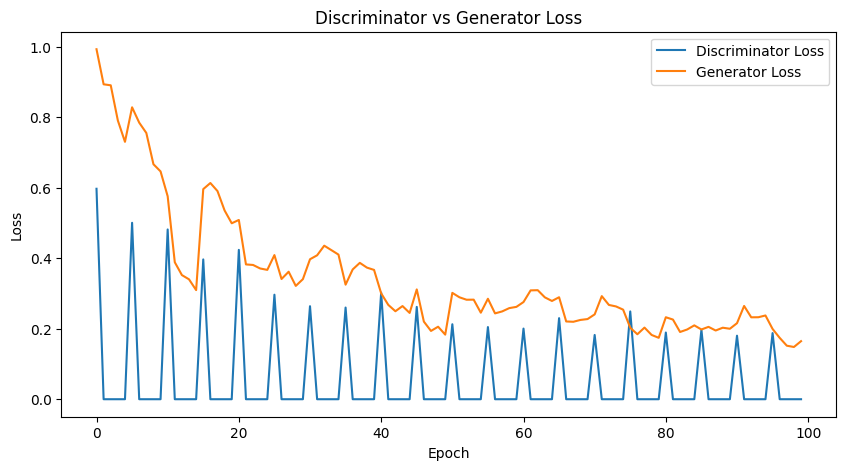

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(range(epochs_v5), d_losses, label='Discriminator Loss')
plt.plot(range(epochs_v5), g_losses, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Discriminator vs Generator Loss')
plt.show()

**Displaying images for variation 4 from epochs 80 to epochs 100**

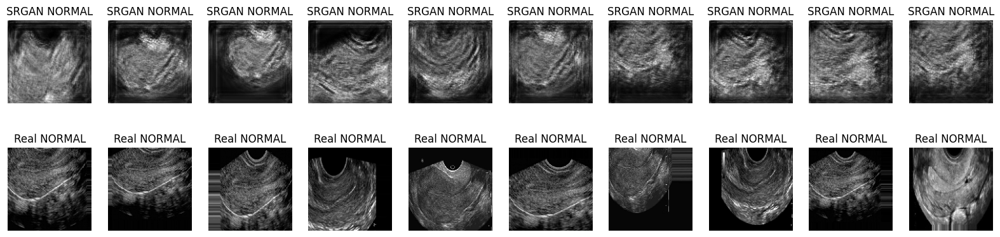

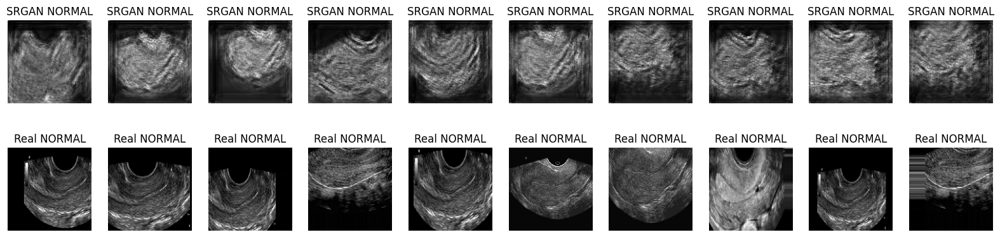

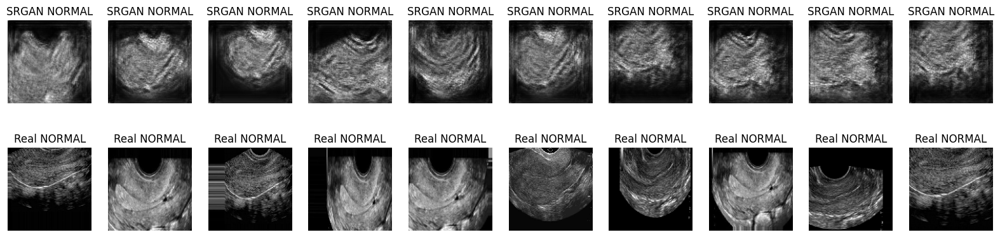

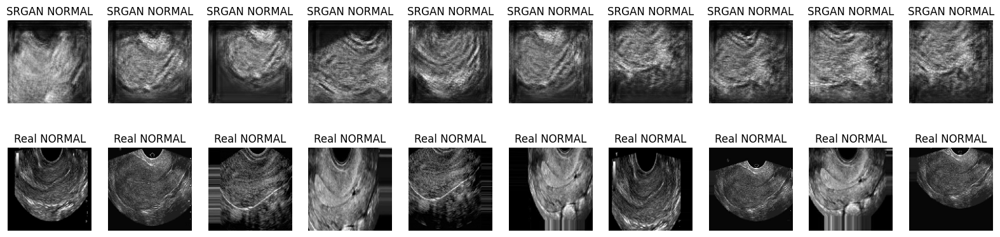

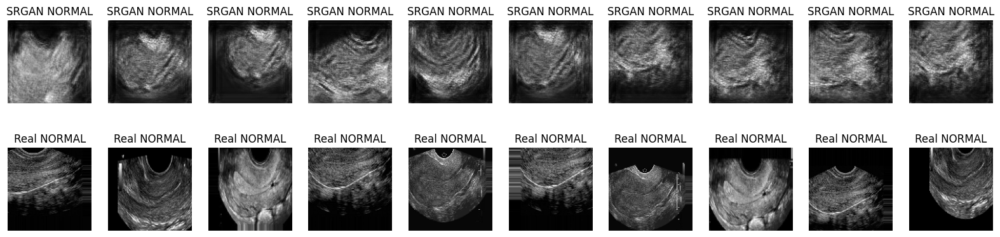

...

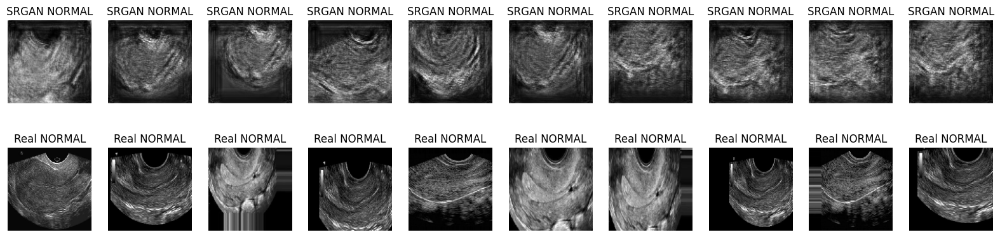

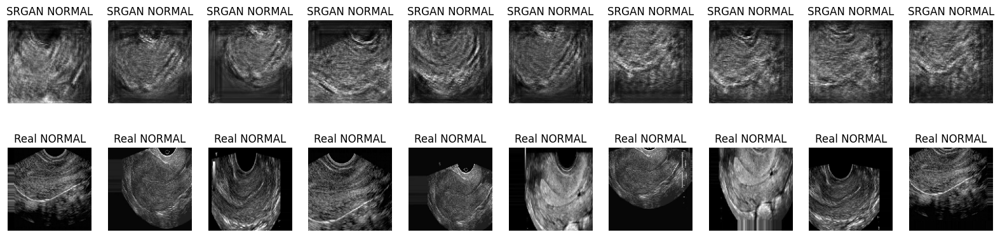

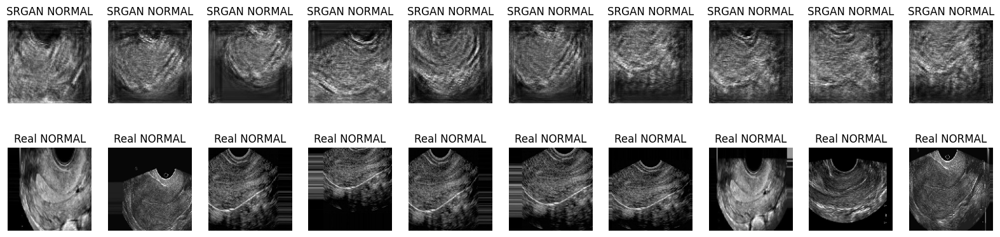

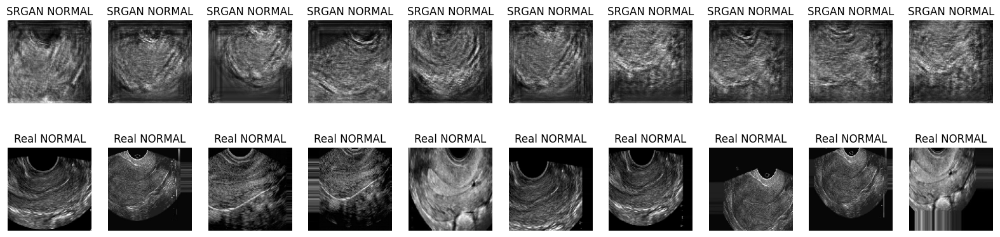

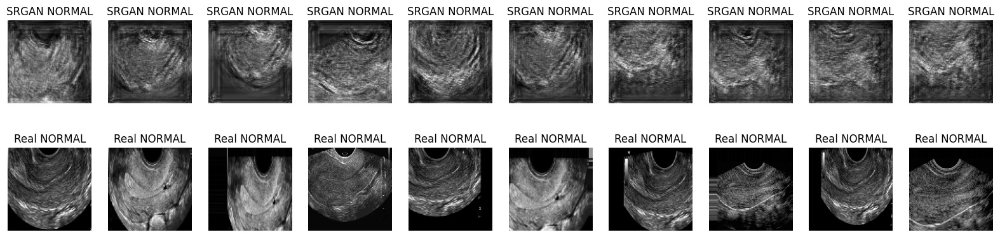

No images found for epoch 100 and class NORMAL


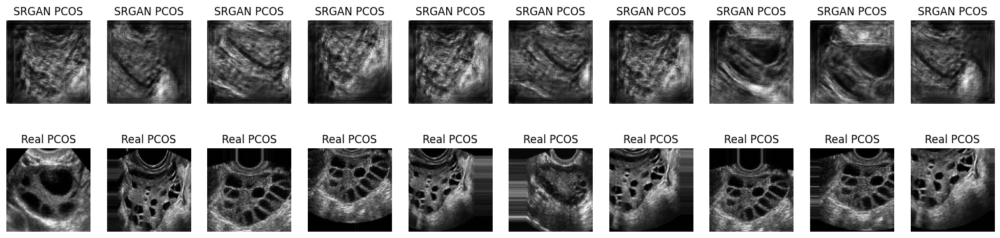

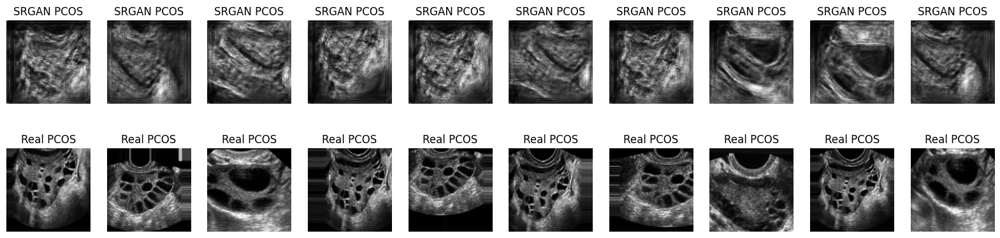

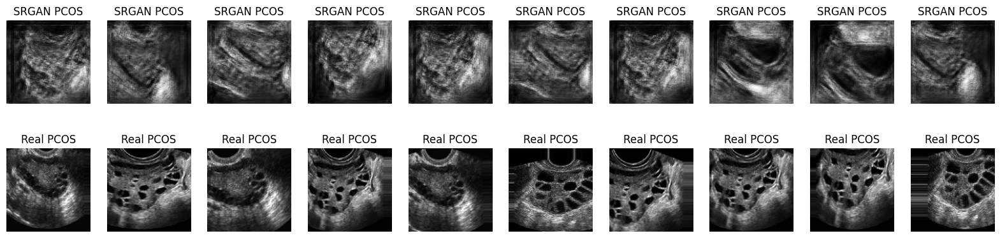

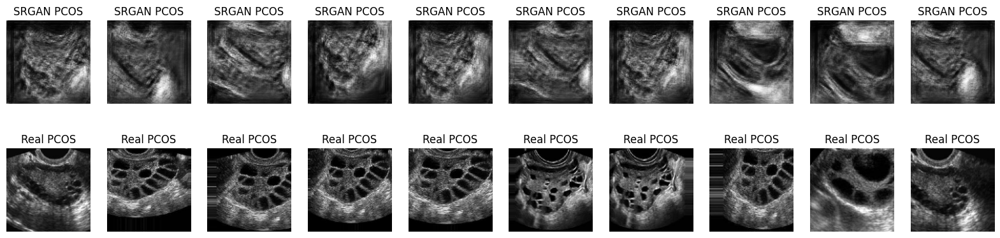

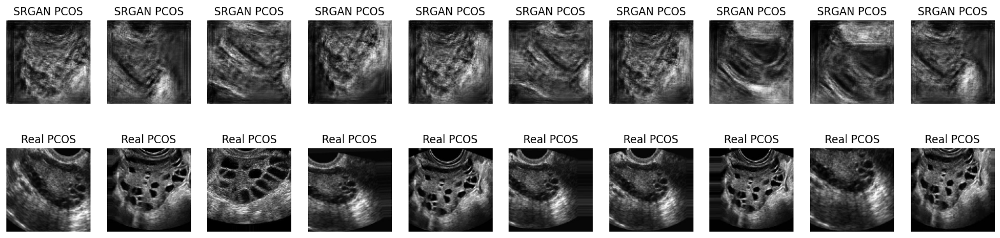

...

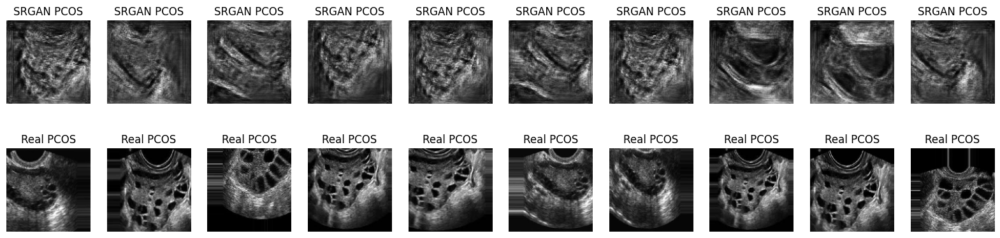

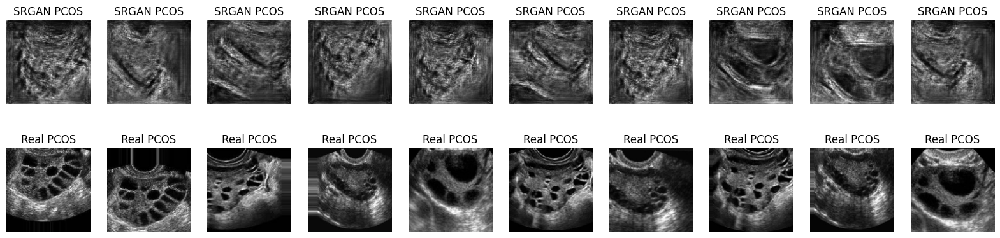

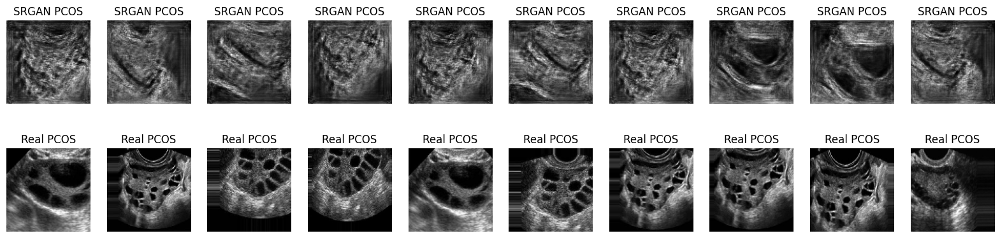

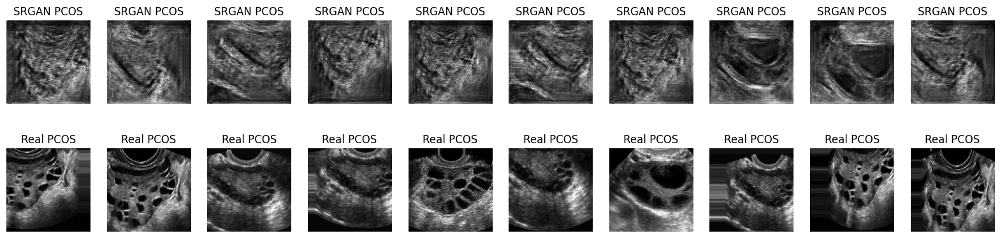

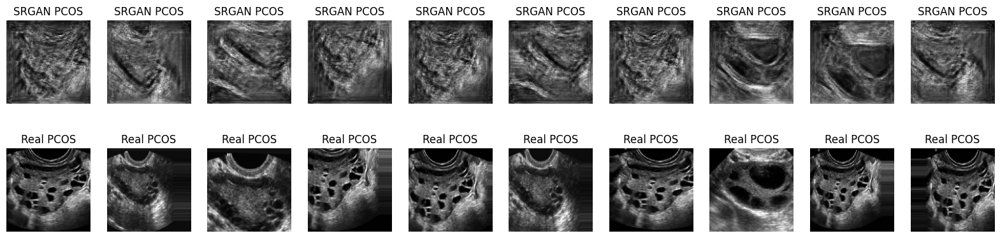

No images found for epoch 100 and class PCOS


In [ ]:
import matplotlib.pyplot as plt
import os
from PIL import Image

def display_generated_vs_real_images(epochs, class_label='NORMAL'):
    if class_label == 'NORMAL':
        data = normal_images
        norm_data = normal_images_norm
        save_path = generated_images_path_normal_v5
    else:
        data = pcos_images
        norm_data = pcos_images_norm
        save_path = generated_images_path_pcos_v5

    for epoch in epochs:
        epoch_path = os.path.join(save_path, f"epoch_{epoch}")
        if not os.path.exists(epoch_path):
            print(f"No images found for epoch {epoch} and class {class_label}")
            continue

        image_files = [os.path.join(epoch_path, img) for img in os.listdir(epoch_path) if img.endswith('.png')]
        idx = np.random.randint(0, data.shape[0], len(image_files))

        plt.figure(figsize=(20, 10))
        for i, img_file in enumerate(image_files[:10]):
            gen_img = Image.open(img_file)
            plt.subplot(4, 10, i+1)
            plt.imshow(gen_img, cmap='gray')
            plt.axis('off')
            plt.title(f"SRGAN {class_label}")

            real_img = data[idx[i]].squeeze()
            plt.subplot(4, 10, i+11)
            plt.imshow(real_img, cmap='gray')
            plt.axis('off')
            plt.title(f"Real {class_label}")

        plt.show()

epochs_to_display = range(80, 101)

display_generated_vs_real_images(epochs_to_display, class_label='NORMAL')
display_generated_vs_real_images(epochs_to_display, class_label='PCOS')

**Calculating SSIM for epochs 80 -90**

In [ ]:
def load_images_from_directory(path, target_size=(256, 256)):
    images = []
    for root, dirs, files in os.walk(path):
        for file in files:
            if file.endswith(('png', 'jpg', 'jpeg')):
                img = imread(os.path.join(root, file), as_gray=True)
                img_resized = resize(img, target_size, anti_aliasing=True)
                images.append(img_resized)
    return images


def calculate_ssim_pair(gen_img, real_img, data_range=1.0):
    return ssim(gen_img, real_img, data_range=data_range)

#average SSIM for real and generated images
def calculate_average_ssim(real_images, generated_images, data_range=1.0, sample_size=10):
    ssim_scores = []

    with ThreadPoolExecutor() as executor:
        futures = []
        for gen_img in generated_images:
            sampled_real_images = random.sample(real_images, min(len(real_images), sample_size))
            for real_img in sampled_real_images:
                futures.append(executor.submit(calculate_ssim_pair, gen_img, real_img, data_range))

        for future in as_completed(futures):
            ssim_scores.append(future.result())

    return np.mean(ssim_scores) if ssim_scores else None

target_size = (256, 256)
normal_real_images = load_images_from_directory(normal_real_path, target_size)
pcos_real_images = load_images_from_directory(pcos_real_path, target_size)

def calculate_epoch_ssim_scores(generated_path, real_images, target_size=(256, 256), data_range=1.0, sample_size=10):
    epochs = [f'epoch_{i}' for i in range(80, 100)]
    epoch_ssim_scores = {}

    for epoch in epochs:
        epoch_generated_path = os.path.join(generated_path, epoch)
        if not os.path.exists(epoch_generated_path):
            print(f"Skipping {epoch_generated_path}, does not exist")
            continue
        generated_images = load_images_from_directory(epoch_generated_path, target_size)
        if not generated_images:
            print(f"No generated images found in {epoch_generated_path}")
            continue
        print(f"Calculating SSIM for {epoch_generated_path}")
        average_ssim = calculate_average_ssim(real_images, generated_images, data_range, sample_size)
        if average_ssim is not None:
            epoch_ssim_scores[epoch] = average_ssim
            print(f"Average SSIM for {epoch}: {average_ssim}")

    return epoch_ssim_scores

normal_ssim_scores = calculate_epoch_ssim_scores(normal_generated_path, normal_real_images, target_size)
pcos_ssim_scores = calculate_epoch_ssim_scores(pcos_generated_path, pcos_real_images, target_size)

print("Average SSIM for Normal Class:")
for epoch, score in normal_ssim_scores.items():
    print(f"{epoch}: {score}")

print("\nAverage SSIM for PCOS Class:")
for epoch, score in pcos_ssim_scores.items():
    print(f"{epoch}: {score}")


Calculating SSIM for /content/drive/My Drive/var4doingagainforgraph/allnormal/epoch_80
Average SSIM for epoch_80: 0.11142032815147608
Calculating SSIM for /content/drive/My Drive/var4doingagainforgraph/allnormal/epoch_81
Average SSIM for epoch_81: 0.11552789993251154
Calculating SSIM for /content/drive/My Drive/var4doingagainforgraph/allnormal/epoch_82
Average SSIM for epoch_82: 0.13075463826285794
Calculating SSIM for /content/drive/My Drive/var4doingagainforgraph/allnormal/epoch_83
Average SSIM for epoch_83: 0.11226575465558009
Calculating SSIM for /content/drive/My Drive/var4doingagainforgraph/allnormal/epoch_84
Average SSIM for epoch_84: 0.12891536059947928
Calculating SSIM for /content/drive/My Drive/var4doingagainforgraph/allnormal/epoch_85
Average SSIM for epoch_85: 0.12042474387539989
Calculating SSIM for /content/drive/My Drive/var4doingagainforgraph/allnormal/epoch_86
Average SSIM for epoch_86: 0.12044957411582435
Calculating SSIM for /content/drive/My Drive/var4doingagainfor